In [44]:
import cv2
import re
import numpy as np  
import pandas
import glob

from IPython.display import display
from PIL import Image
import matplotlib.pyplot as plt
import os

from scipy import signal
import math


In [2]:
from skimage.metrics import structural_similarity as ssim

In [3]:
from pathlib import Path

How to Threshold 

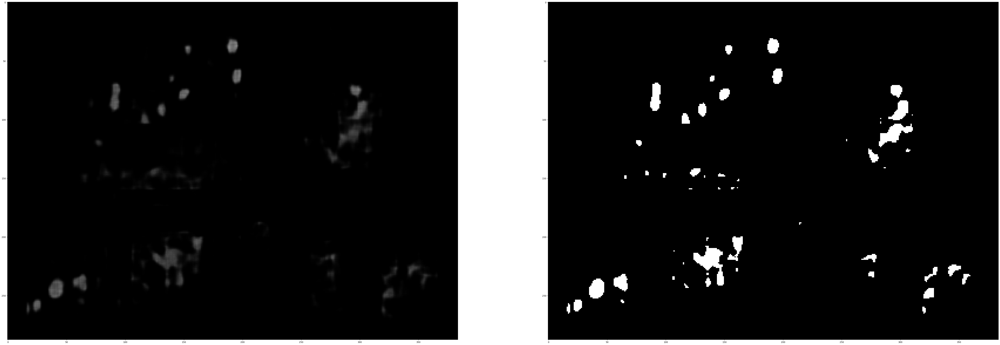

In [65]:
fig = plt.figure(figsize=(80, 40))
  
  # setting values to rows and column variables
rows = 1
columns = 2

pred_im = cv2.imread("/Users/poojamukund/Documents/Vision Lab/saliency-prediction/model-7-results/predictions/eem003_8988_original_prediction.png")
fig.add_subplot(rows, columns, 1)
plt.imshow(pred_im)


thresh = 20
im_bw = cv2.threshold(pred_im, thresh, 255, cv2.THRESH_BINARY)[1]
fig.add_subplot(rows, columns, 2)
plt.imshow(im_bw)


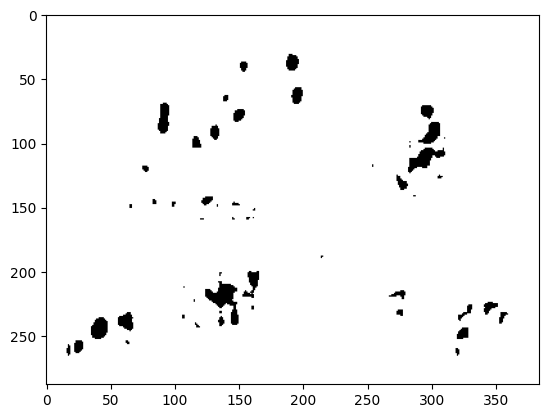

In [67]:
from skimage import util 
inverted_img = util.invert(im_bw)
plt.imshow(inverted_img)

In [64]:
np.invert(pred_im)
plt.show(pred_im)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [ ]:
def invert_bw_masks(img): 
    # Change black/white to white/black
    ## Changes region of interest from black to white 
        input_overlayed_Pred = img.copy()
        input_overlayed_Pred[pred_binary == 255, :] = [255, 0, 0]

In [49]:
pred_array = np.asarray(im_bw)
pred_array.shape
pred_array = pred_array.flatten()

pred_array.shape

(331776,)

In [5]:
def show_thresholded_pred(img): 
    
    
    fig = plt.figure(figsize=(80, 40))
  
  # setting values to rows and column variables
    rows = 1
    columns = 2

    pred_im = cv2.imread(img)
    fig.add_subplot(rows, columns, 1)
    plt.imshow(pred_im)


    thresh = 20
    im_bw = cv2.threshold(pred_im, thresh, 255, cv2.THRESH_BINARY)[1]
    fig.add_subplot(rows, columns, 2)
    plt.imshow(im_bw)

    plt.show()
        

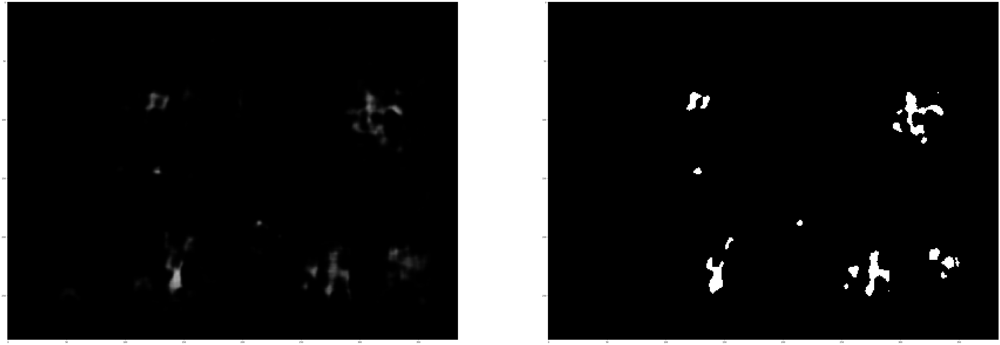

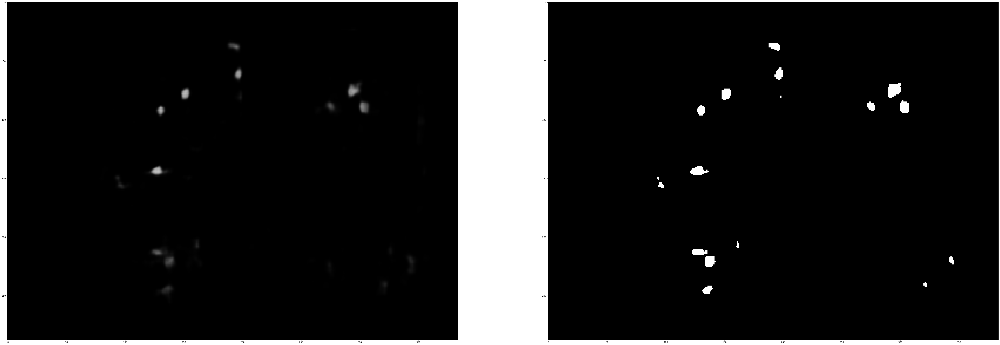

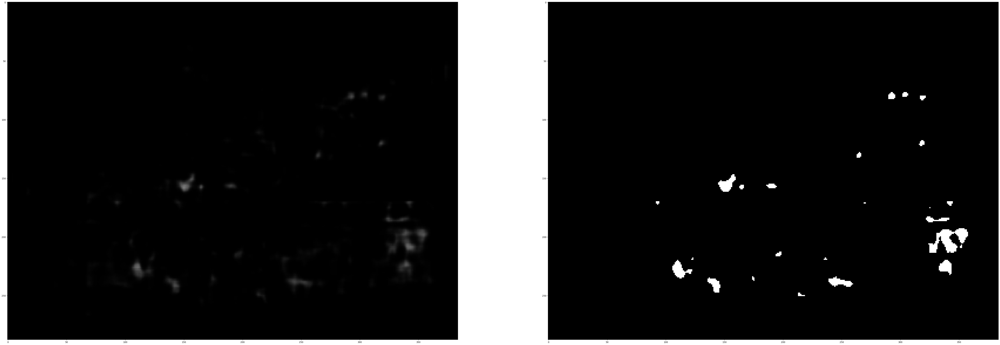

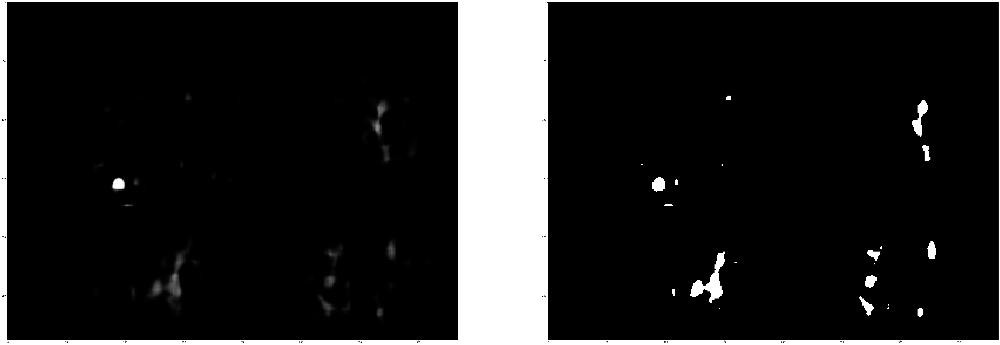

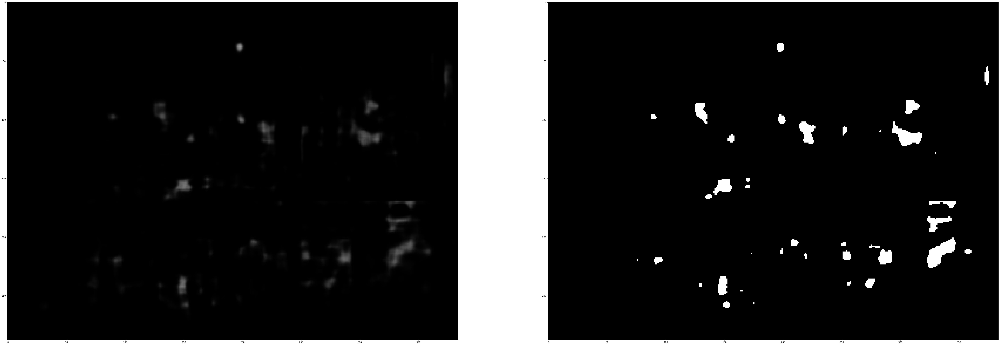

...

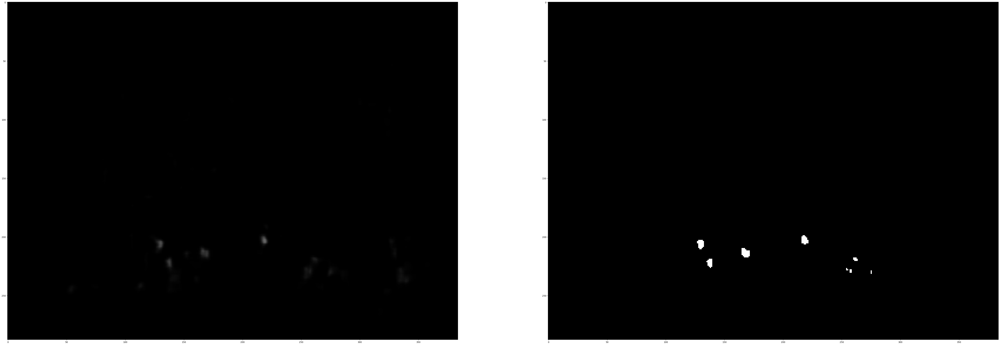

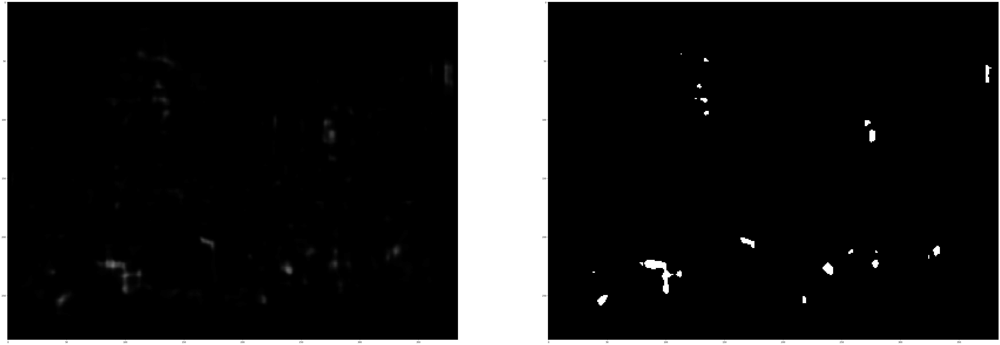

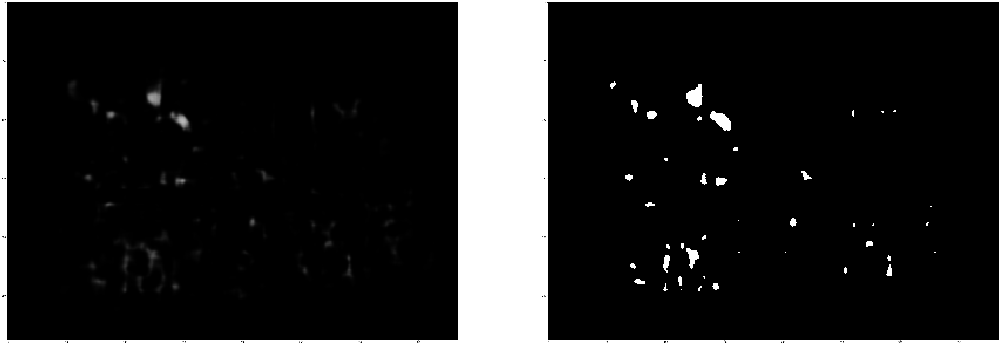

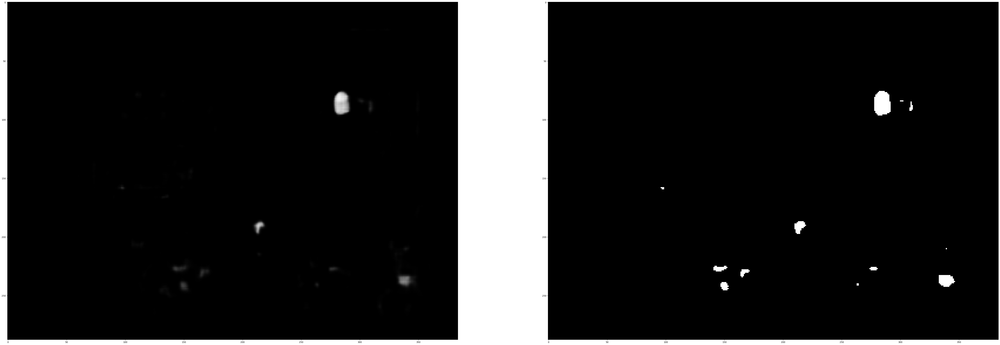

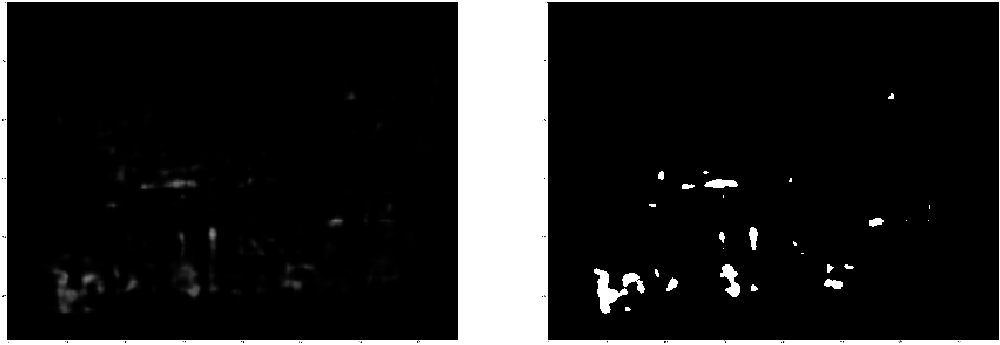

In [5]:
for file in glob.glob("/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-24-results/predictions/"+"/*.png"): 
    show_thresholded_pred(file)

Get correlation coefficient of prediction and ground truth 

* Logic *


        function 
        
            create correlation coefficient list 
            For file in predictions folder: 
                get image id 
                find image id in ground truth folder 
                find correlation coefficient of images
                append item to dictionary 
            
            print avg correlation coefficient 



In [6]:
import math

In [46]:
# Import dice loss
def dice(pred, true, k = 255):
    intersection = np.sum(pred[true==k]) * 2.0
    dice = intersection / (np.sum(pred) + np.sum(true))
    return dice

In [47]:
def get_correlation_coefficient(prediction_folder, gt_folder):

    # Create empty correlation coefficient list  
    cc_list = []
    mse_list = []
    psnr_list = []
    ssim_list = []
    dice_list = []

    # Loop through prediction images
    for image in glob.glob(prediction_folder+"/*.png"): 

        # Get id of image 
        file_name = image.split("/")[-1]
        id = file_name.split("_original_prediction.png")[0]

        # Threshold image 
        pred_im = cv2.imread(image)
        thresh=20
        im_thresh = cv2.threshold(pred_im, thresh, 255, cv2.THRESH_BINARY)[1]

        # Get ground truth image
        for root, dirs, files in os.walk(gt_folder):
            for file in files:
                if file.startswith(id): 
                    gt=file
                    
        gt_im = cv2.imread(root+"/"+gt)

        # Create subplot 
        ### Prediction Image
        fig = plt.figure(figsize=(80, 40))
        fig.add_subplot(1, 2, 1)
        plt.imshow(im_thresh)
        plt.title("Prediction", fontdict={'fontsize': 100})
        plt.axis('off')
        ### Ground Truth Image
        fig.add_subplot(1, 2, 2)
        plt.imshow(gt_im)
        plt.title("Ground Truth", fontdict={'fontsize': 100})
        plt.axis('off')
       
        plt.show()
        
        # Print instance correlation coefficient 
        cor = np.corrcoef(np.array(im_thresh).flatten(), np.array(gt_im).flatten())[1,0]
         # Calculate the MSE between the two images
        mse = np.mean((gt_im - im_thresh) ** 2)
        
        # Calculate the maximum pixel value of the images
        max_pixel = 255.0

        # Calculate the PSNR between the two images
        psnr = 20 * math.log10(max_pixel) - 10 * math.log10(np.mean((gt_im - im_thresh) ** 2))

        
        # Calculate the SSIM between the two images
        from skimage.metrics import structural_similarity as ssim
        ssim_score, _ = ssim(gt_im, im_thresh, multichannel=True, full=True)
        dice_score = dice(im_thresh, gt_im, k = 255)

        print(id)
        print("Correlation Coefficient: ", cor)
        print("MSE: ", mse)
        print("PSNR: ", psnr)
        print("SSIM: ", ssim_score)
        print ("Dice Similarity: {}".format(dice_score))
        # Append to cclist 
        cc_list.append(cor)
        mse_list.append(mse)
        psnr_list.append(psnr)
        ssim_list.append(ssim_score)
        dice_list.append(dice_score)
    
    # Print mean correlation coefficient
    mean_cc = sum(cc_list) / len(cc_list)
    mean_mse = sum(mse_list) / len(mse_list)
    mean_psnr = sum(psnr_list) / len(psnr_list)
    mean_ssim = sum(ssim_list) / len(ssim_list)
    mean_dice = sum(dice_list) / len(dice_list)
    print("Mean Correlation Coefficient: " + str(mean_cc))
    print("Mean MSE: " + str(mean_mse))
    print("Mean PSNR: " + str(mean_psnr))
    print("Mean SSIM: " + str(mean_ssim))
    print("Mean Dice Score: " + str(mean_dice))

    

        


# Model 7 Results

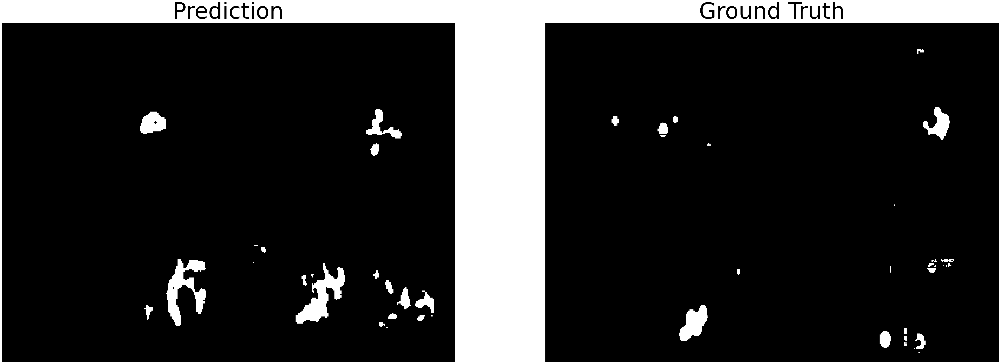

/var/folders/66/mwk1x7h96cgcvcj0wf91s_pc0000gn/T/ipykernel_3617/2197702566.py:59: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_score, _ = ssim(gt_im, im_thresh, multichannel=True, full=True)


eem005_9108
Correlation Coefficient:  0.044932144060780395
MSE:  0.06325050636574074
PSNR:  60.120163541668255
SSIM:  0.9094713242419082
Dice Similarity: 0.05461254317113031


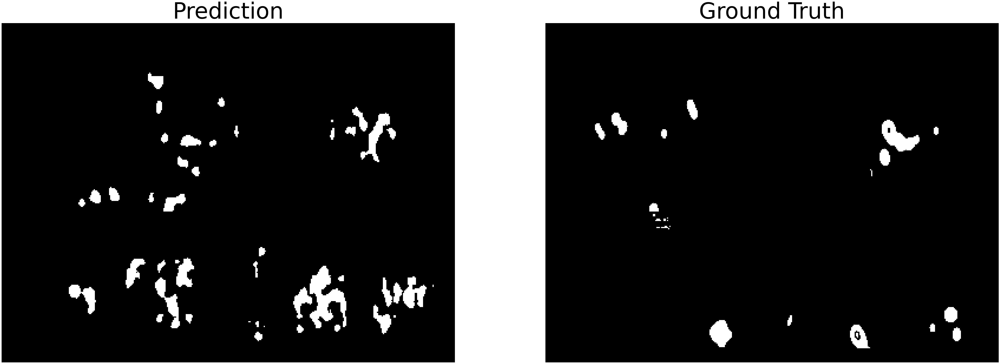

eem011_9025
Correlation Coefficient:  0.03223996470596749
MSE:  0.10353370949074074
PSNR:  57.97998586318765
SSIM:  0.8532933393485486
Dice Similarity: 0.04911157849625844


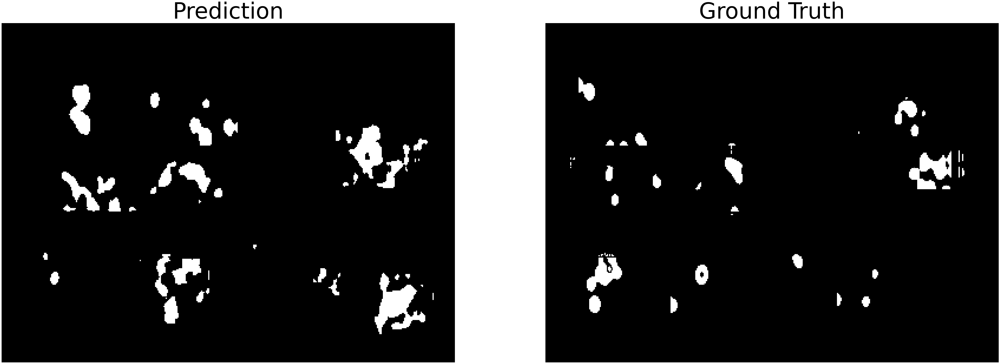

eem016_8914
Correlation Coefficient:  0.15514885642384058
MSE:  0.12706163194444445
PSNR:  57.09065931874684
SSIM:  0.8367898983764709
Dice Similarity: 0.16943121314225135


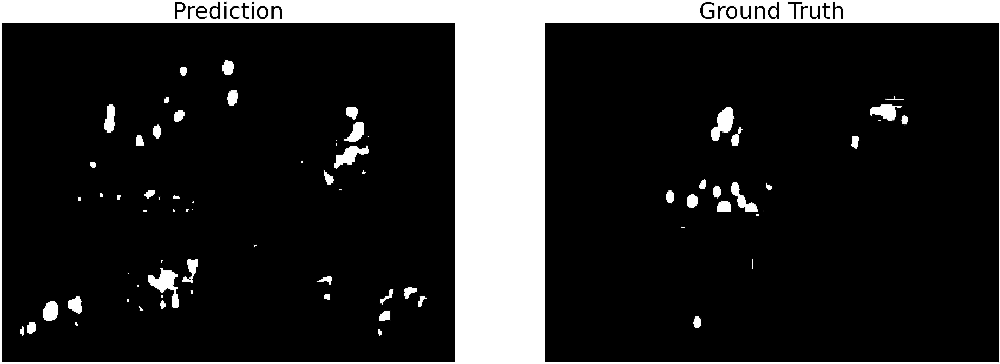

eem003_8988
Correlation Coefficient:  0.060718549790170696
MSE:  0.07227466724537036
PSNR:  59.540942600247945
SSIM:  0.8921005749406379
Dice Similarity: 0.07172498591116348


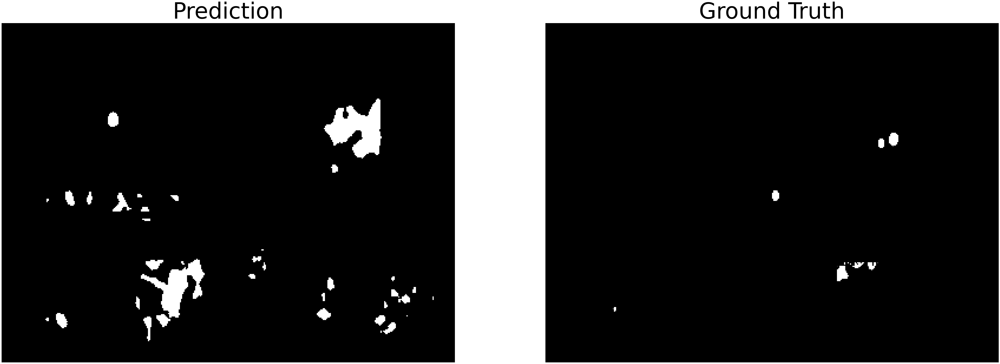

eem008_9016
Correlation Coefficient:  0.034485256727038616
MSE:  0.05090784143518518
PSNR:  61.06295678143326
SSIM:  0.9076954692306024
Dice Similarity: 0.02397537465355277


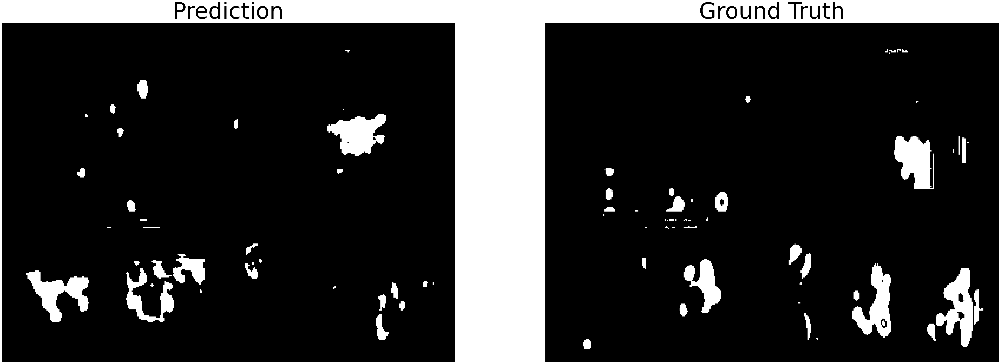

eem007_9105
Correlation Coefficient:  0.1330405917072821
MSE:  0.16605179398148148
PSNR:  55.928367889006886
SSIM:  0.8338117480767803
Dice Similarity: 0.16519129317147296


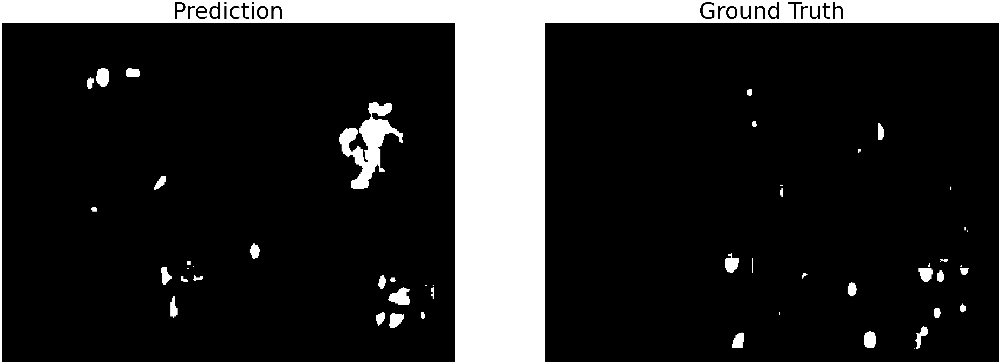

eem010_9059
Correlation Coefficient:  0.019499477135255218
MSE:  0.06599030671296297
PSNR:  59.936002139660424
SSIM:  0.9116609971230316
Dice Similarity: 0.02849792592949694


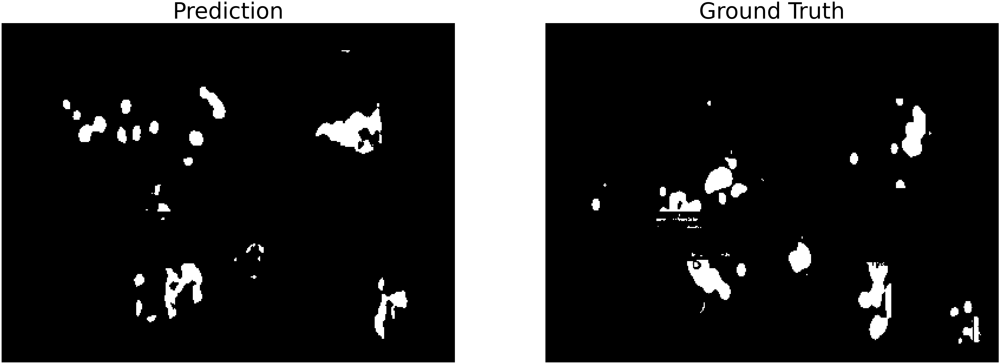

eem007_9222
Correlation Coefficient:  0.1217825853185506
MSE:  0.15541811342592593
PSNR:  56.215787279828064
SSIM:  0.8496388465280912
Dice Similarity: 0.15068040807104746


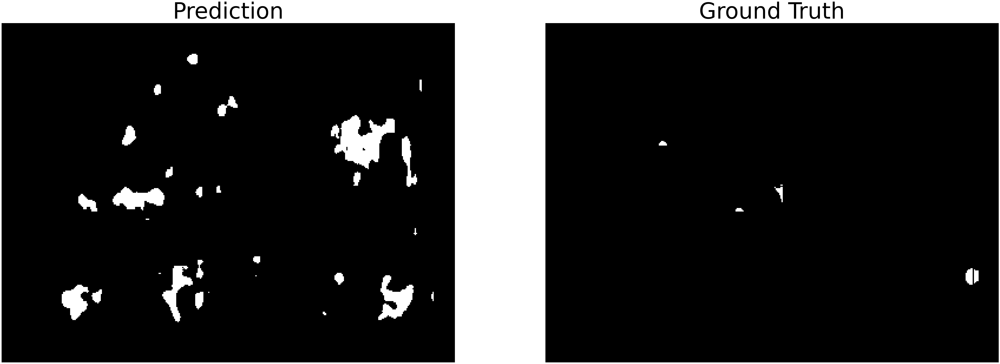

eem009_9191
Correlation Coefficient:  -0.007545169304344021
MSE:  0.05027488425925926
PSNR:  61.117292814126145
SSIM:  0.8960055350763141
Dice Similarity: 0.0


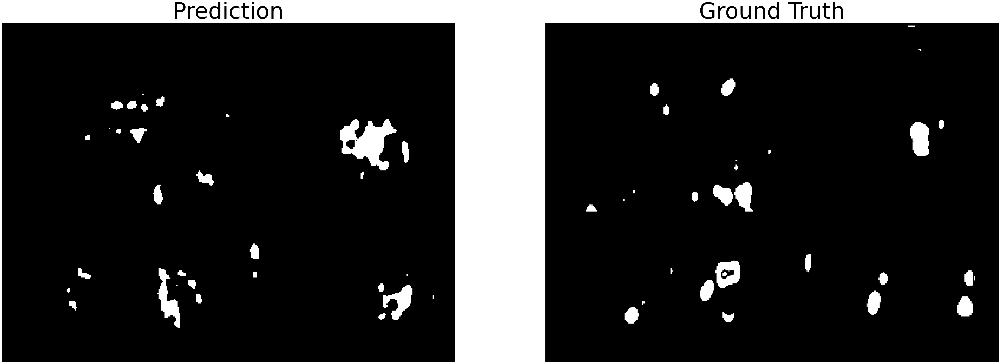

eem006_9198
Correlation Coefficient:  0.16380198207824614
MSE:  0.10283745659722222
PSNR:  58.00929033848575
SSIM:  0.8892495029425677
Dice Similarity: 0.1808156081907848


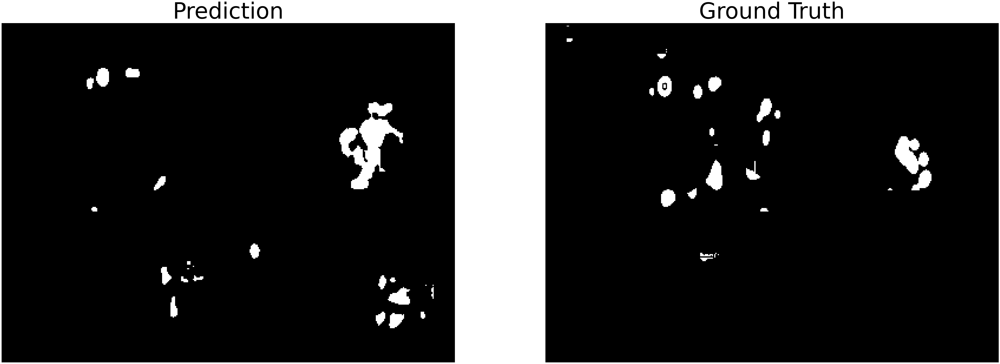

eem016_9059
Correlation Coefficient:  0.15432607334037457
MSE:  0.08470775462962964
PSNR:  58.85157190930365
SSIM:  0.9033113423880922
Dice Similarity: 0.1667391281844249


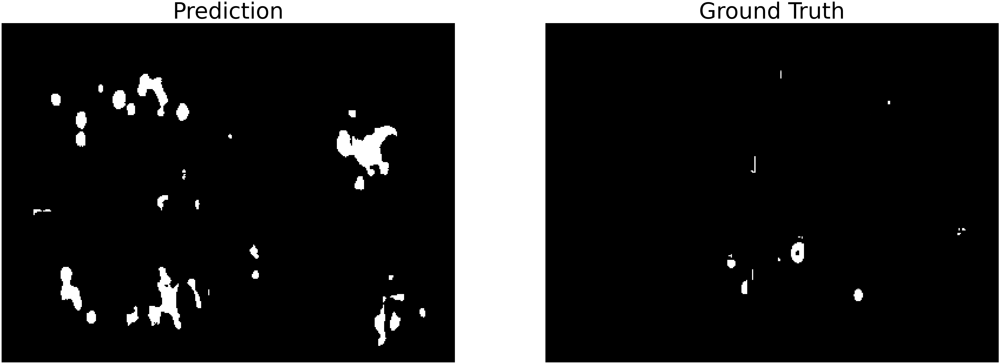

eem010_9219
Correlation Coefficient:  0.023031657563606395
MSE:  0.05391890914351852
PSNR:  60.813392636489326
SSIM:  0.8932625977004506
Dice Similarity: 0.018743058748867215


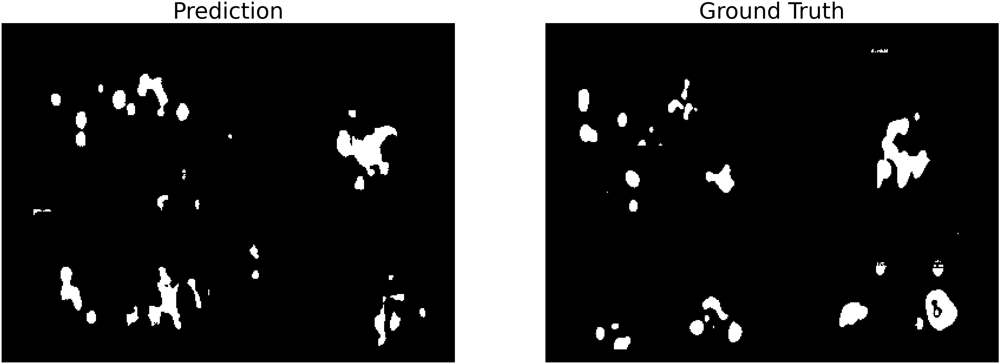

eem011_9219
Correlation Coefficient:  0.2209653384657411
MSE:  0.1657443576388889
PSNR:  55.93641608032455
SSIM:  0.8507739291176861
Dice Similarity: 0.24522880007327097


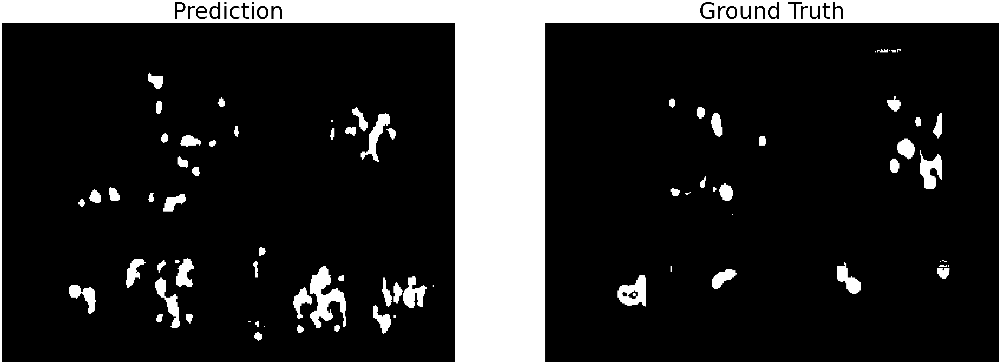

eem016_9025
Correlation Coefficient:  0.1106248268084767
MSE:  0.11560510706018519
PSNR:  57.501033406323174
SSIM:  0.8491765063485164
Dice Similarity: 0.12670954903689222


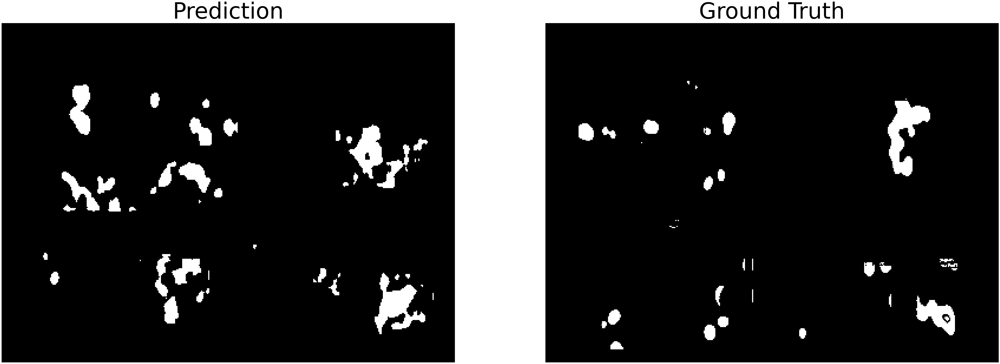

eem011_8914
Correlation Coefficient:  0.13998375861460952
MSE:  0.15673828125
PSNR:  56.17905280766831
SSIM:  0.8326256780993667
Dice Similarity: 0.16011931402931295


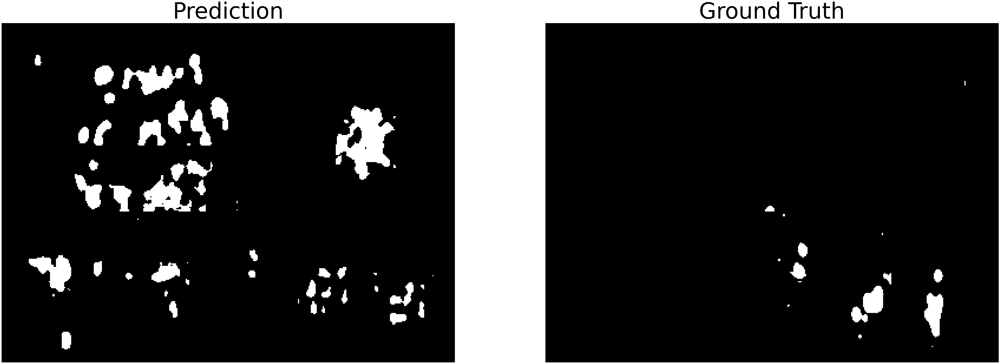

eem010_8974
Correlation Coefficient:  0.04612934369514723
MSE:  0.10491717303240741
PSNR:  57.92233780750646
SSIM:  0.813599834869993
Dice Similarity: 0.04821218153131262


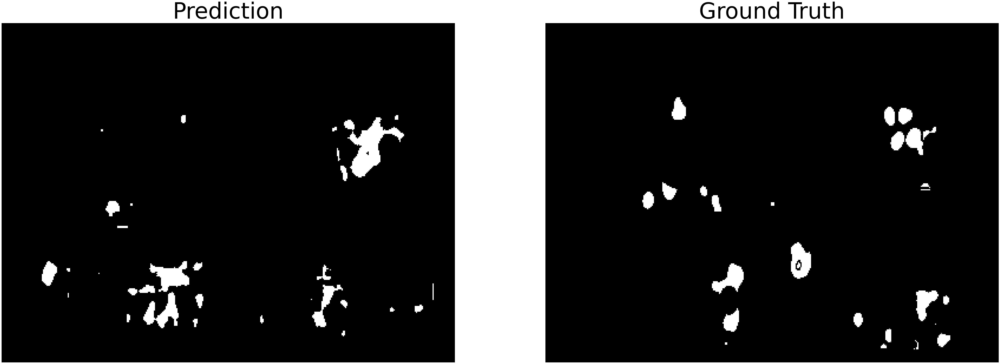

eem007_8935
Correlation Coefficient:  0.15937815725094578
MSE:  0.10627350983796297
PSNR:  57.866553368423666
SSIM:  0.8831066599756784
Dice Similarity: 0.1771676383906816


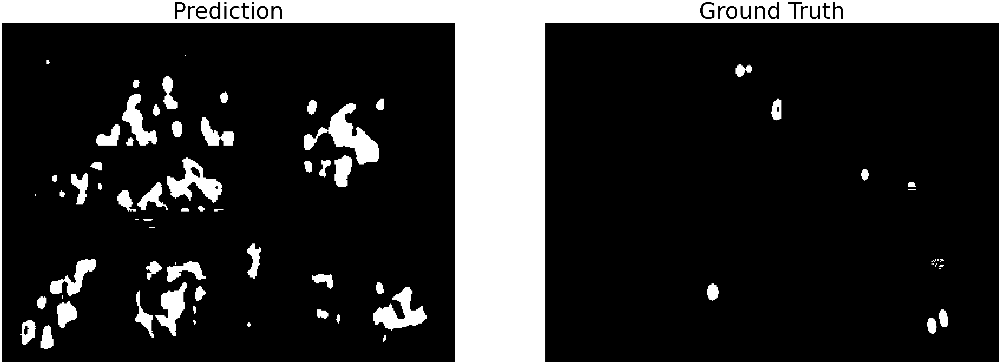

eem005_8909
Correlation Coefficient:  0.06716697207924696
MSE:  0.10146303530092593
PSNR:  58.0677251062627
SSIM:  0.8001927904482774
Dice Similarity: 0.04032301146865938


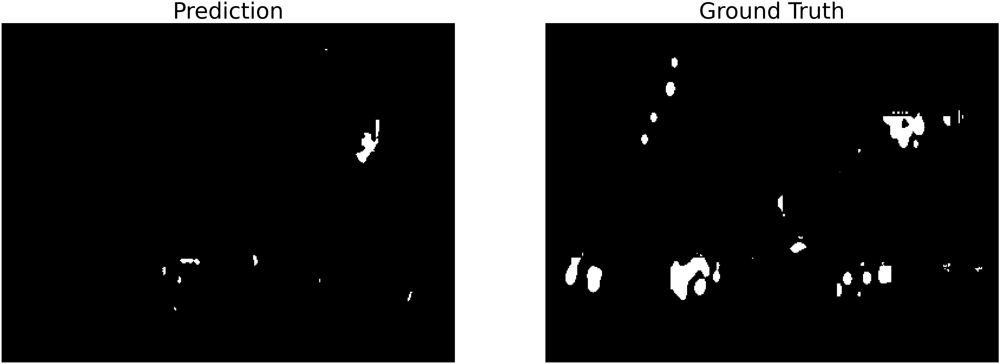

eem008_8898
Correlation Coefficient:  0.09483931940167975
MSE:  0.08379448784722222
PSNR:  58.898649099735586
SSIM:  0.9290835116476885
Dice Similarity: 0.06672862478603542


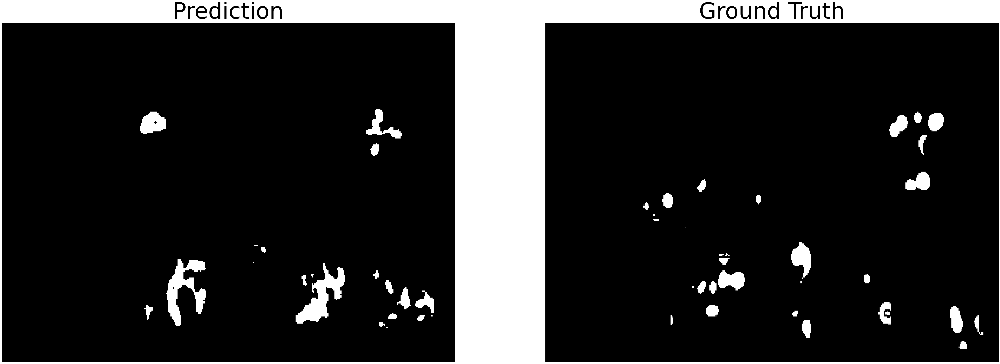

eem007_9108
Correlation Coefficient:  0.12037490811587363
MSE:  0.1031810619212963
PSNR:  57.99480367625387
SSIM:  0.8960033378463318
Dice Similarity: 0.13659270048984481


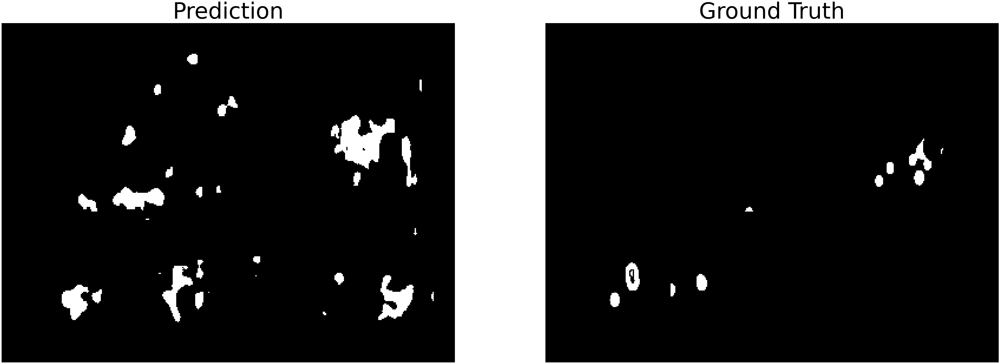

eem016_9191
Correlation Coefficient:  0.09721230107251051
MSE:  0.08301685474537036
PSNR:  58.93914085602881
SSIM:  0.8887026894814364
Dice Similarity: 0.08047355246969402
Mean Correlation Coefficient: 0.09486366166909524
Mean MSE: 0.1008076878031305
Mean PSNR: 58.37962501527196
Mean SSIM: 0.8723598149432605
Mean Dice Score: 0.10290849952124545


In [12]:
pred_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-22-model-results/predictions"
ground_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-22-model-results/ground_truth"

get_correlation_coefficient(pred_folder, ground_folder)

# Model 9 Results 

In [42]:
pred_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-23-model-results/predictions"
ground_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-23-model-results/saliency"

get_correlation_coefficient(pred_folder, ground_folder)

ZeroDivisionError: division by zero

# 3-24 Model Results 

- Participants 1-16 (Excluding 2,4,14,17)

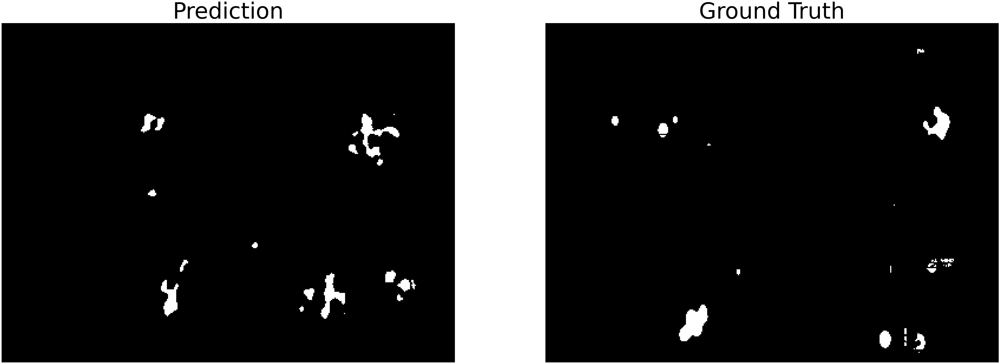

/var/folders/66/mwk1x7h96cgcvcj0wf91s_pc0000gn/T/ipykernel_17400/2197702566.py:59: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_score, _ = ssim(gt_im, im_thresh, multichannel=True, full=True)


eem005_9108
Correlation Coefficient:  0.04182609577124649
MSE:  0.055248119212962965
PSNR:  60.707628627521174
SSIM:  0.9283233025145842
Dice Similarity: 0.05240474666635351


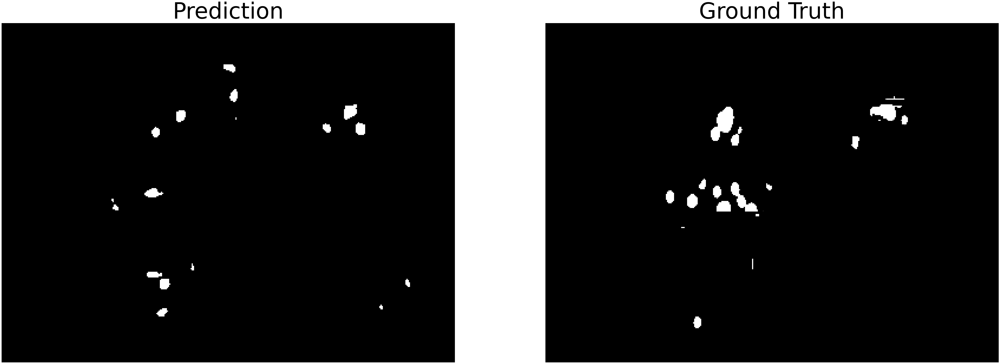

eem003_8988
Correlation Coefficient:  0.1532381157038125
MSE:  0.05636935763888889
PSNR:  60.62037275053851
SSIM:  0.9445789718786556
Dice Similarity: 0.1529167453275439


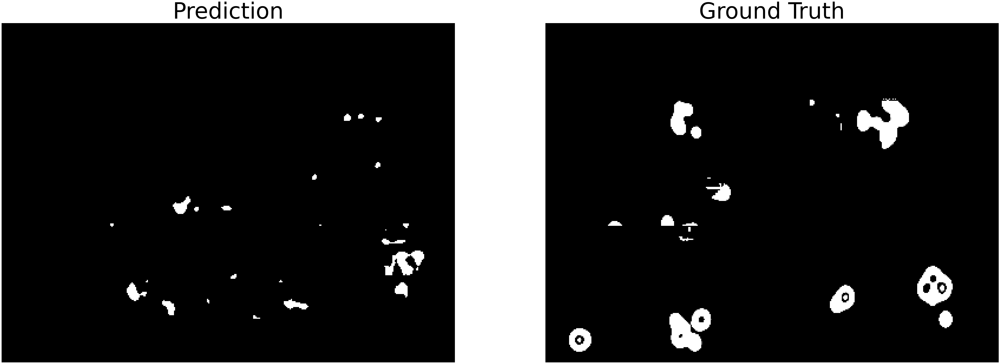

eem011_059_OS
Correlation Coefficient:  0.10078340167421052
MSE:  0.18156828703703703
PSNR:  55.5404036452169
SSIM:  0.8976331686319746
Dice Similarity: 0.09430114148583618


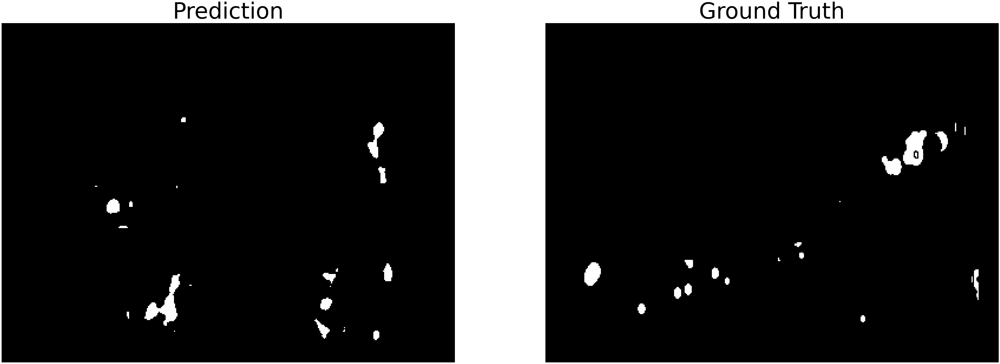

eem008_8935
Correlation Coefficient:  0.09567835831749882
MSE:  0.06769929108796297
PSNR:  59.82496239866633
SSIM:  0.9336429232399431
Dice Similarity: 0.10471898825346733


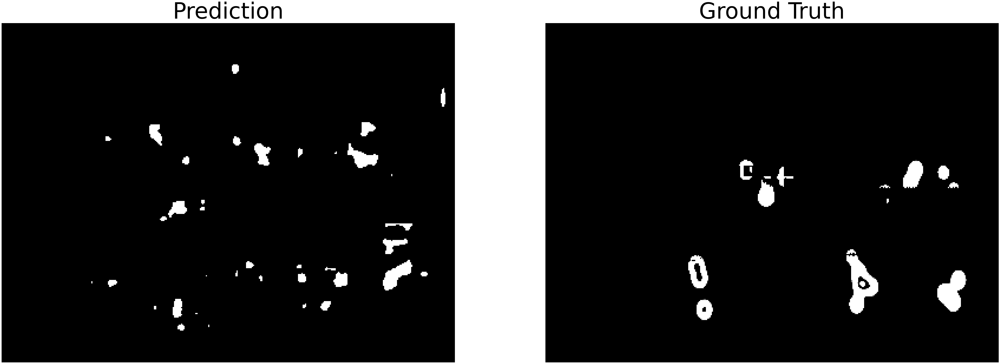

eem009_085_OD
Correlation Coefficient:  -0.0032009059897206084
MSE:  0.12146448206018519
PSNR:  57.28631058244943
SSIM:  0.8906093091303776
Dice Similarity: 0.016202751634228248


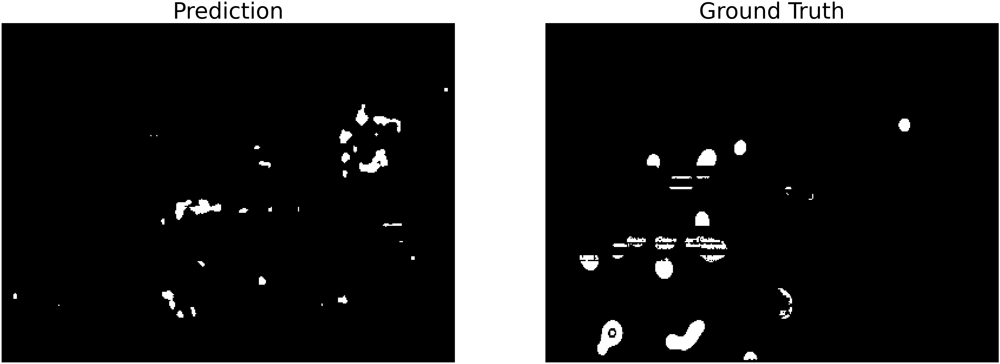

eem016_093_OD
Correlation Coefficient:  0.007319530221234694
MSE:  0.09275535300925926
PSNR:  58.45741378264937
SSIM:  0.8896054137012482
Dice Similarity: 0.021888680425265792


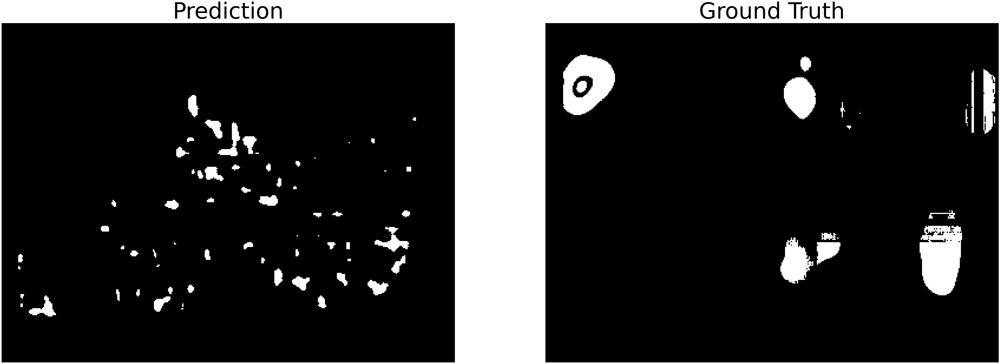

eem010_127_OD
Correlation Coefficient:  0.058115263717481734
MSE:  0.2156032986111111
PSNR:  54.79424959837232
SSIM:  0.8302168610557702
Dice Similarity: 0.083098807461249


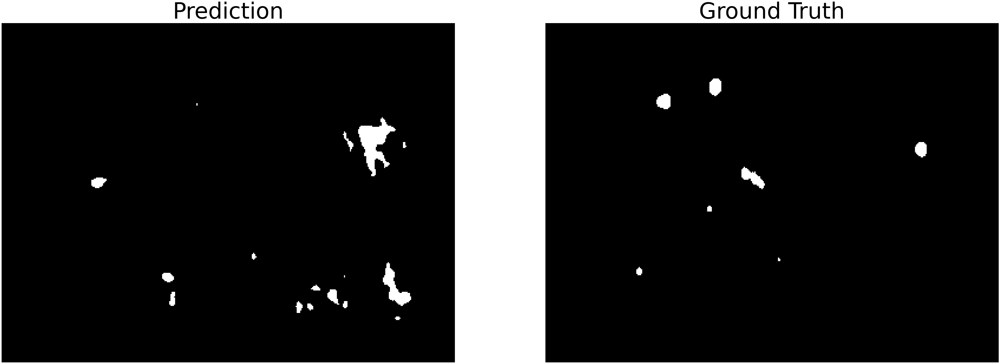

eem008_9238
Correlation Coefficient:  0.06902330526222206
MSE:  0.030978732638888888
PSNR:  63.2201671436518
SSIM:  0.9482790604130935
Dice Similarity: 0.06661314053682355


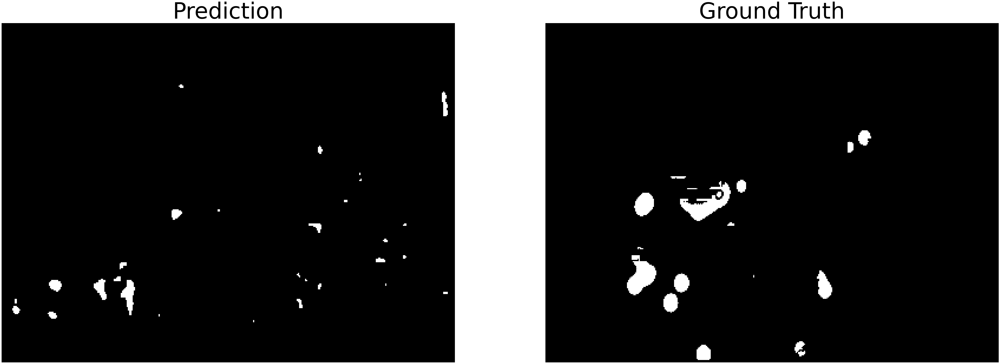

eem013_078_OS
Correlation Coefficient:  0.10858398151157753
MSE:  0.09737594039351852
PSNR:  58.246286960333094
SSIM:  0.9219515333436602
Dice Similarity: 0.10316929499717423


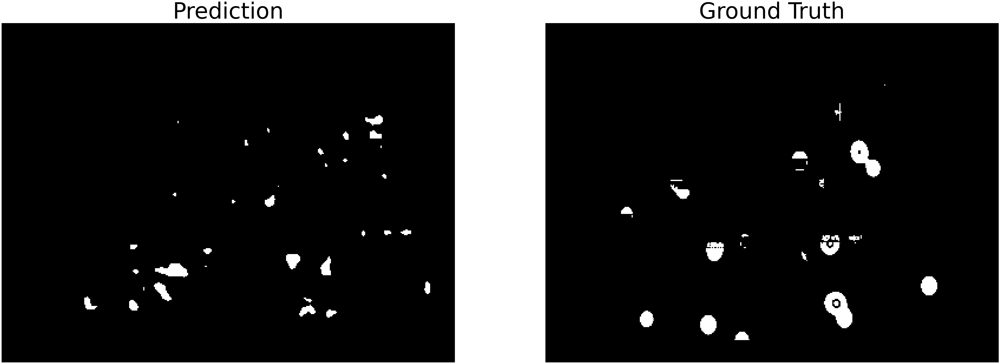

eem011_087_OS
Correlation Coefficient:  0.02042253436716409
MSE:  0.09535951967592593
PSNR:  58.337163059992264
SSIM:  0.9059303307612648
Dice Similarity: 0.03330618176982282


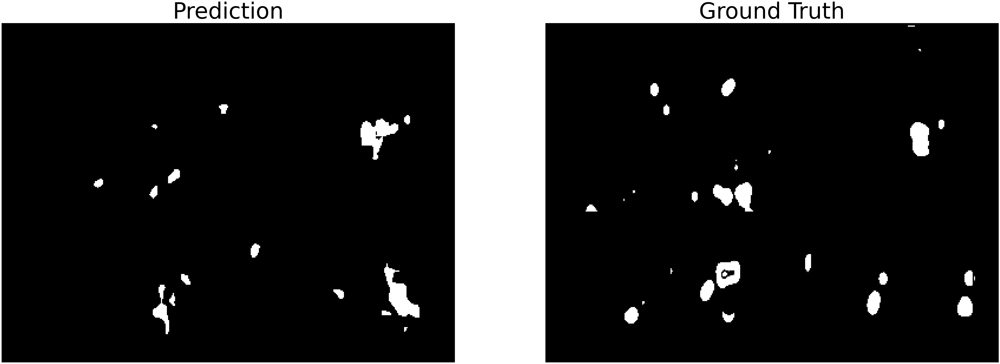

eem006_9198
Correlation Coefficient:  0.18932529190429126
MSE:  0.09684244791666667
PSNR:  58.270146021628165
SSIM:  0.9124978214762504
Dice Similarity: 0.19860142177738743


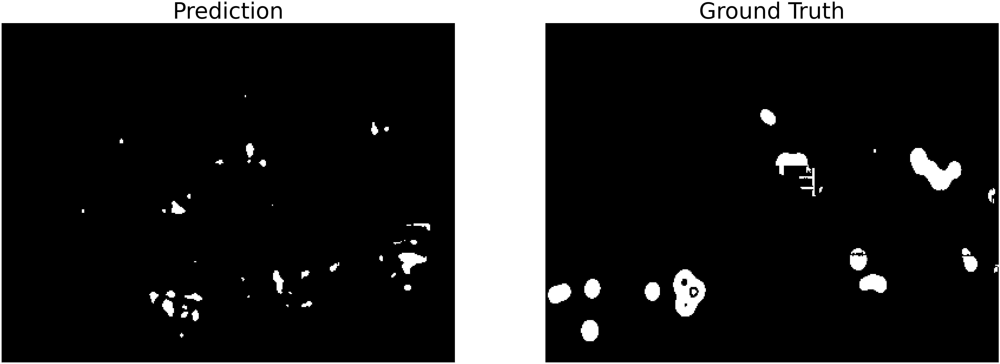

eem009_073_OD
Correlation Coefficient:  0.02931497356328315
MSE:  0.12347186053240741
PSNR:  57.2151236851892
SSIM:  0.8906449013930534
Dice Similarity: 0.038620661801641254


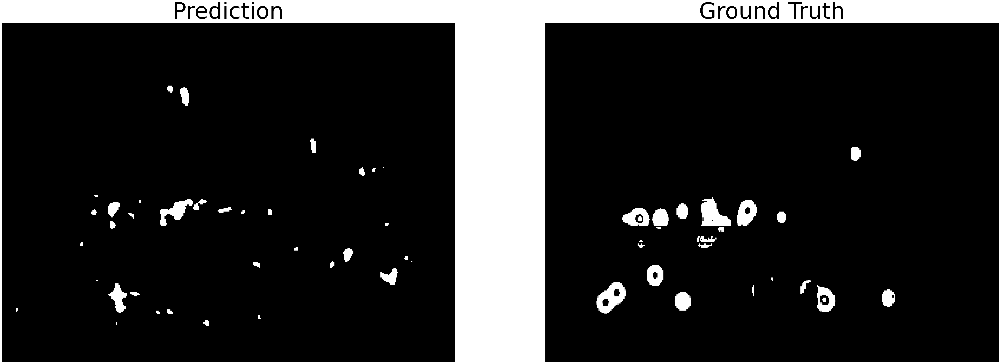

eem013_028_OS
Correlation Coefficient:  0.12269525237740837
MSE:  0.1298285590277778
PSNR:  56.997101239975905
SSIM:  0.9094351529368211
Dice Similarity: 0.12514759181494298


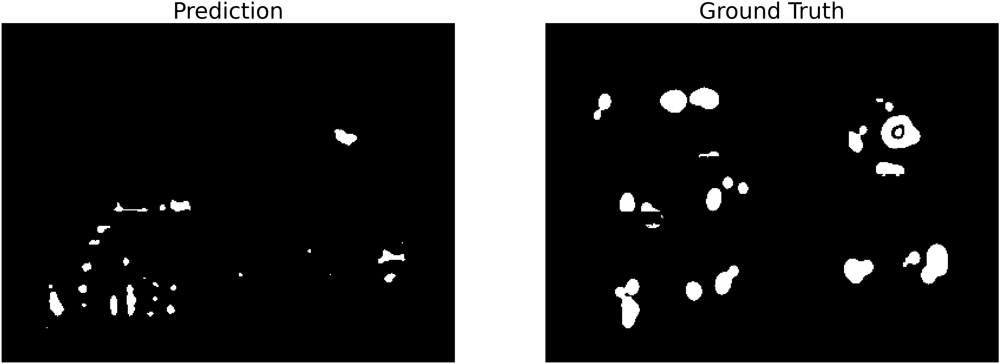

eem011_019_OS
Correlation Coefficient:  0.14528446248279558
MSE:  0.17771629050925927
PSNR:  55.633531212786664
SSIM:  0.8842865330799653
Dice Similarity: 0.13061543251103597


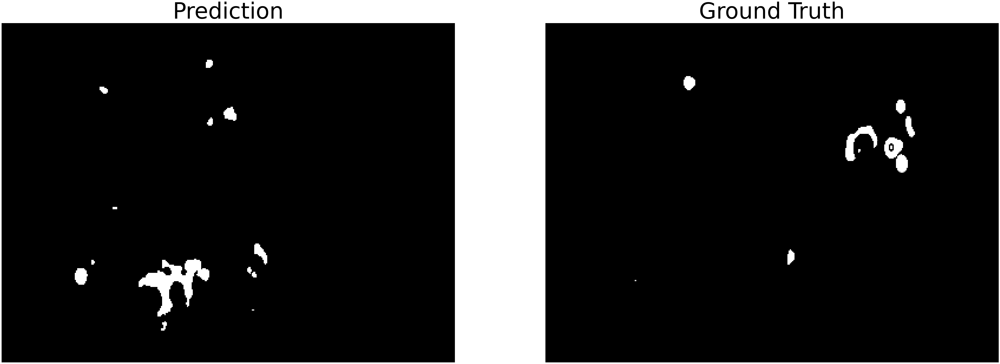

eem008_9184
Correlation Coefficient:  -0.010895181655017286
MSE:  0.052092375578703706
PSNR:  60.96306197768145
SSIM:  0.9405438201717743
Dice Similarity: 0.0


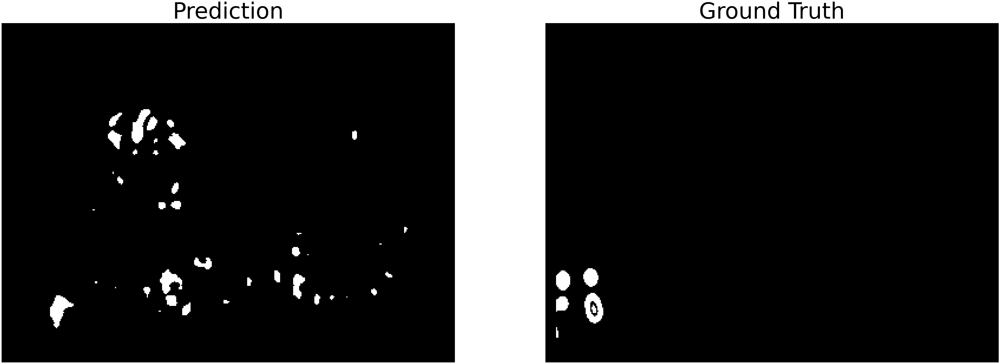

eem015_009_OD
Correlation Coefficient:  0.06867509295024637
MSE:  0.05101634837962963
PSNR:  61.053709911753245
SSIM:  0.9245308710211845
Dice Similarity: 0.06729745535245693


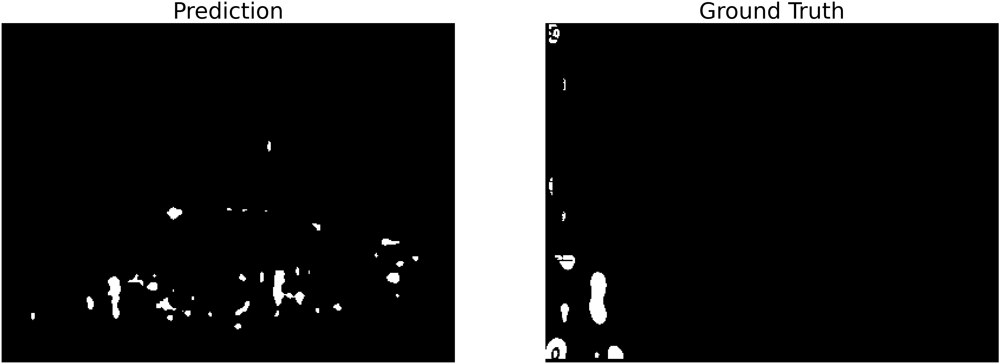

eem015_081_OD
Correlation Coefficient:  -0.011821714809297402
MSE:  0.0709544994212963
PSNR:  59.62100420385442
SSIM:  0.9220746219023198
Dice Similarity: 0.0


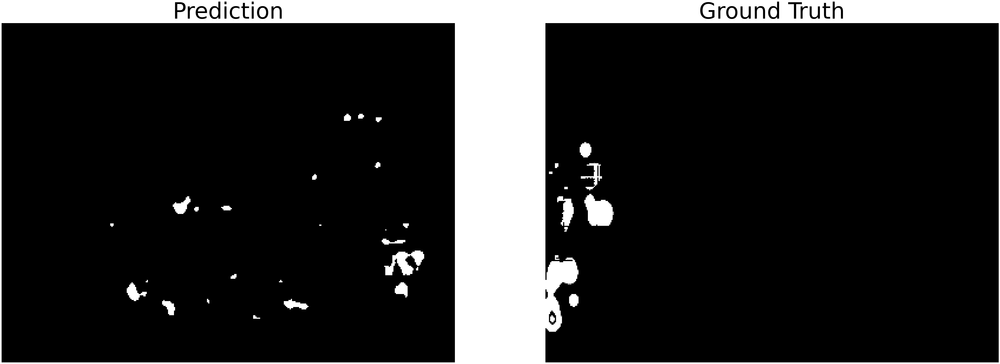

eem015_059_OS
Correlation Coefficient:  -0.013359079036648411
MSE:  0.07212094907407407
PSNR:  59.55018927691073
SSIM:  0.925204978733809
Dice Similarity: 0.0


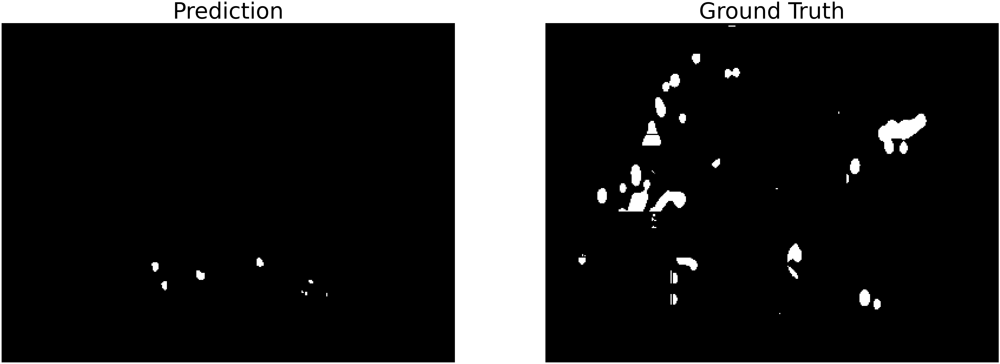

eem008_9189
Correlation Coefficient:  0.002172128175856858
MSE:  0.11542426215277778
PSNR:  57.50783253854403
SSIM:  0.921661734471242
Dice Similarity: 0.002666746843369147


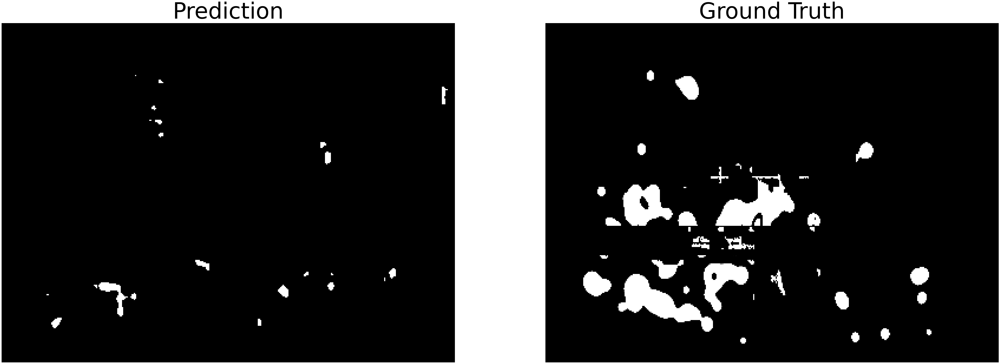

eem013_018_OS
Correlation Coefficient:  0.06416911251429701
MSE:  0.27512839988425924
PSNR:  53.73544938502872
SSIM:  0.8404089412513877
Dice Similarity: 0.044802093793592304


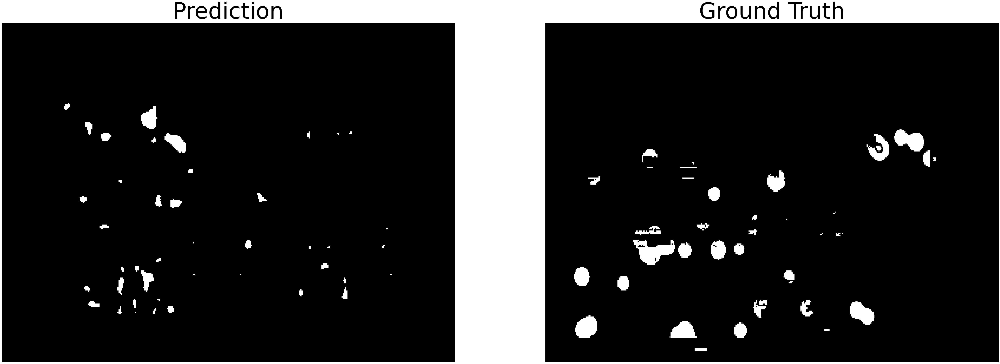

eem016_047_OS
Correlation Coefficient:  -0.013821412813793647
MSE:  0.13219762731481483
PSNR:  56.9185670037283
SSIM:  0.868439093038274
Dice Similarity: 0.0031299810096950503


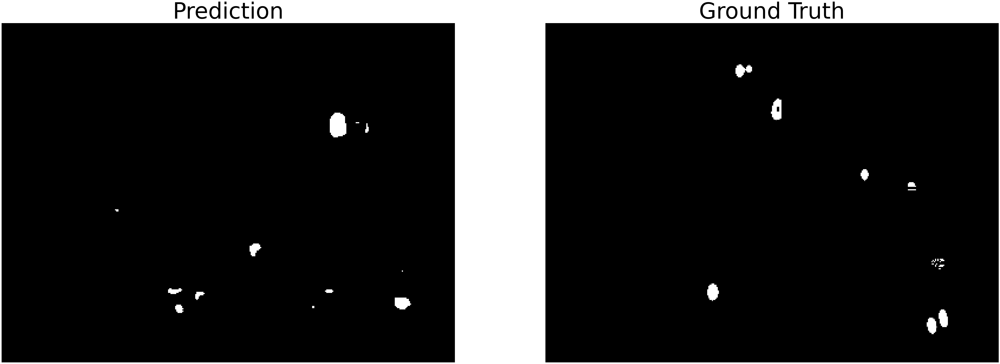

eem005_8909
Correlation Coefficient:  0.03327377846243142
MSE:  0.03297706886574074
PSNR:  62.94868309680891
SSIM:  0.9647793437588751
Dice Similarity: 0.03685394734681141


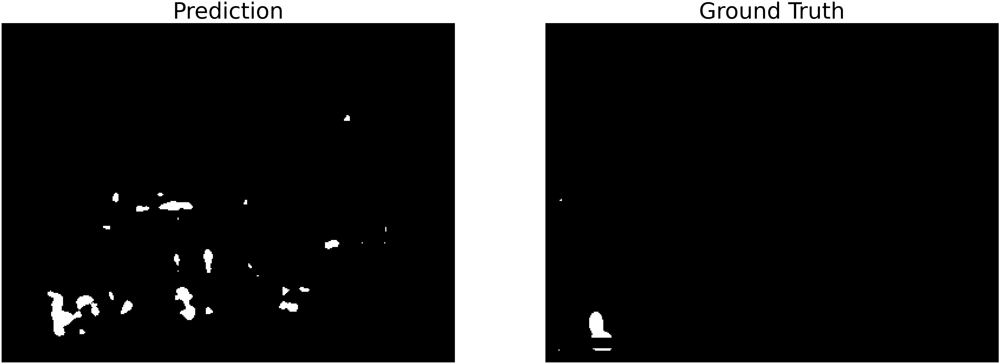

eem015_068_OD
Correlation Coefficient:  0.15251342827003636
MSE:  0.023781105324074073
PSNR:  64.36848324504913
SSIM:  0.945568961289359
Dice Similarity: 0.10885893444702642
Mean Correlation Coefficient: 0.0612746005627225
Mean MSE: 0.10295539892814008
Mean PSNR: 58.77468875427523
Mean SSIM: 0.9104716369215168
Mean Dice Score: 0.0645745541415532


In [45]:
pred_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-24-results/predictions"
ground_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-24-results/gt"

get_correlation_coefficient(pred_folder, ground_folder)

# Get TranSalNet Paper Metrics

In [20]:
import scipy

In [45]:
# Import loss functions from paper 
import torch as t 

# KLD
def KLdiv(pred_map, gt_map):
    eps = 2.2204e-16
    pred_map = pred_map/sum(pred_map)
    gt_map = gt_map/sum(gt_map)
    pred_map = pred_map.astype(int)
    gt_map = gt_map.astype(int)
    print(pred_map)
    print(gt_map)
    div = gt_map * math.log(eps+(gt_map/(eps+pred_map)))
    return div 



# SIM
def sim(pred_map,gt_map):
    diff = min(pred_map, gt_map)
    
    return diff

In [58]:
def sim(pred_map, gt_map): 
    min_value=[]
    pred_norm  = pred_map/255 
    gt_norm = gt_map/255
    pred_list = pred_norm.tolist()
    gt_list_ = gt_norm.tolist()

    for i in range(len(pred_norm)):
        a = pred_norm[i]
        b=gt_norm[i]
        if a>b:
            value = a 
        else: 
            value=b
        min_value.append(value)

        sum(min_value)


In [133]:
def get_trans_metrics(prediction_folder, gt_folder):

    # Create empty correlation coefficient list  
    cc_list = []
    kld_list = []
    sim_list = []

    # Loop through prediction images
    for image in glob.glob(prediction_folder+"/*.png"): 

        # Get id of image 
        file_name = image.split("/")[-1]
        id = file_name.split("_original_prediction.png")[0]

        # Threshold image 
        pred_im = cv2.imread(image)
        thresh=20
        im_thresh = cv2.threshold(pred_im, thresh, 255, cv2.THRESH_BINARY)[1]

        # Get ground truth image
        for root, dirs, files in os.walk(gt_folder):
            for file in files:
                if file.startswith(id): 
                    gt=file
                    
        gt_im = cv2.imread(root+"/"+gt)

        # Create subplot 
        ### Prediction Image
        fig = plt.figure(figsize=(80, 40))
        fig.add_subplot(1, 2, 1)
        plt.imshow(im_thresh)
        plt.title("Prediction", fontdict={'fontsize': 100})
        plt.axis('off')
        ### Ground Truth Image
        fig.add_subplot(1, 2, 2)
        plt.imshow(gt_im)
        plt.title("Ground Truth", fontdict={'fontsize': 100})
        plt.axis('off')
       
        plt.show()
        
        # Print instance correlation coefficient 
        cor = np.corrcoef(np.array(im_thresh).flatten(), np.array(gt_im).flatten())[1,0]
        print(np.array(im_thresh).flatten().shape)
         # Calculate the MSE between the two images
        # kld = KLdiv(np.array(im_thresh).flatten(), np.array(gt_im).flatten())
        
        # Calculate similarity 
        simil = sim(np.array(im_thresh).flatten(), np.array(gt_im).flatten())

        print(id)
        print("Correlation Coefficient: ", cor)
        print("KLD: ", kld)
        # Append to cclist 
        cc_list.append(cor)
        # kld_list.append(kld)
        sim_list.append(simil)
    
    # Print mean correlation coefficient
    mean_cc = sum(cc_list) / len(cc_list)
    # kld_sum= sum(kld_list)
    sim_sum = sum(sim_list)
    
    print("KLD Loss: ", kld_sum)
    

    

        


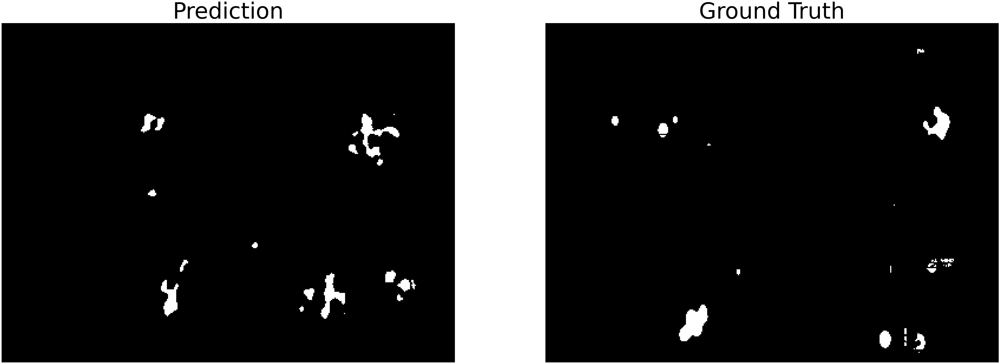

(331776,)


KeyboardInterrupt: 

In [60]:
pred_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-24-results/predictions"
ground_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-24-results/gt"

get_trans_metrics(pred_folder, ground_folder)

# Overlayed Predictions

In [38]:
def get_metrics_and_overlay(prediction_folder, gt_folder, org_folder):

    # Loop through prediction images
    for image in glob.glob(prediction_folder+"/*.png"): 

        # Get id of image 
        file_name = image.split("/")[-1]
        id = file_name.split("_original_prediction.png")[0]

        # Threshold image 
        pred_im = cv2.imread(image)
        thresh=20
        im_thresh = cv2.threshold(pred_im, thresh, 255, cv2.THRESH_BINARY)[1]

        from skimage import util 
        inverted_img = util.invert(im_thresh)
        

        # Get ground truth image
        for root, dirs, files in os.walk(gt_folder):
            for file in files:
                if file.startswith(id): 
                    gt=file
        gt_im = cv2.imread(root+"/"+gt)

        # Get background image
        for root, dirs, files in os.walk(org_folder):
            for file in files:
                if file.startswith(id): 
                    orig=file
        org_im = cv2.imread(root+"/"+orig)

        
        
        
        coords = np.column_stack(np.where(im_thresh ==255 ))
        for coord in coords: 

            # ### if heatmap input 
            org_im[coord[0],coord[1]]=(255,0,0)

        # inverted_img[np.all(inverted_img == (0,0,0), axis=-1)] = (255,0,0)
        # dst = cv2.addWeighted(inverted_img, 0.5 , org_im, 0.5, 0)
        # plt.imshow(dst)
        # #added_image = cv2.addWeighted(org_im,0.4,inverted_img,0.1,0)
        # added_image = cv2.addWeighted(inverted_img, 1, org_im, 1, 0, org_im)


        fig = plt.figure(figsize=(80, 40))
        fig.add_subplot(1, 2, 1)
        plt.imshow(org_im[:,:,::-1])
        plt.title("Prediction", fontdict={'fontsize': 100})
        plt.axis('off')

        
        fig.add_subplot(1, 2, 2)
        plt.title("Ground Truth", fontdict={'fontsize': 100})
        plt.imshow(gt_im[:,:,::-1])
        plt.axis('off')
        

        # overlay_path = str(Path(prediction_folder).parents[0])+"/overlay_images"
        # if not os.path.exists(overlay_path):
        #             os.makedirs(overlay_path)

        # fig.savefig(overlay_path+"/"+id+"_overlay.png")

        # ov_im = cv2.imread(overlay_path+"/"+id+"_overlay.png")
        # # Create subplot 
        # ### Prediction Image
        # fig = plt.figure(figsize=(80, 40))
        # plt.imshow(im_thresh)
        # plt.title("Prediction", fontdict={'fontsize': 100})
        # plt.axis('off')
        # ### Ground Truth Image
        # fig.add_subplot(1, 3, 2)
        # plt.imshow(gt_im)
        # plt.title("Ground Truth", fontdict={'fontsize': 100})
        # plt.axis('off')

        # ### Overlayed Image
        # fig.add_subplot(1, 3, 3)
        # plt.imshow(ov_im)
        # plt.title("Prediction Overlayed w Ground Truth", fontdict={'fontsize': 100})
        # plt.axis('off')

       

    

/var/folders/66/mwk1x7h96cgcvcj0wf91s_pc0000gn/T/ipykernel_17400/666405770.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(80, 40))


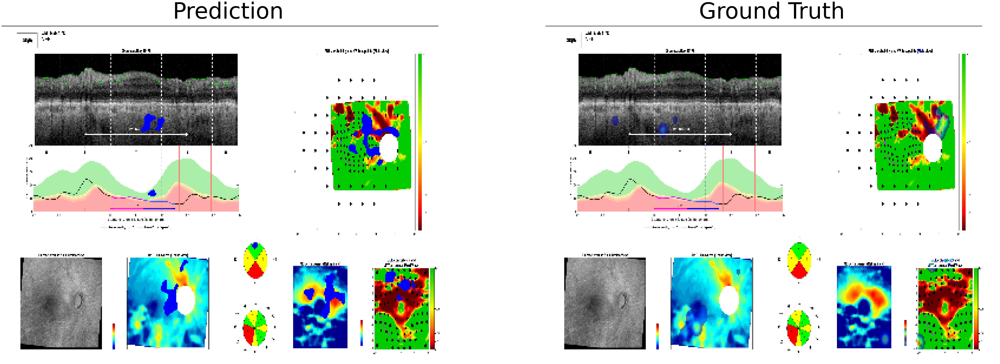

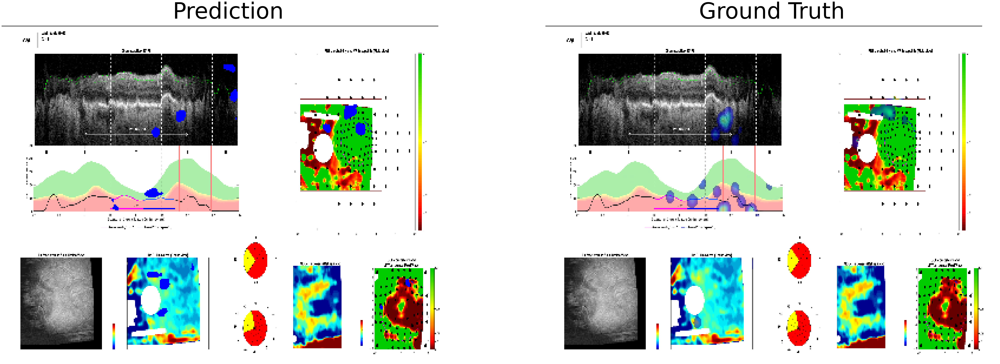

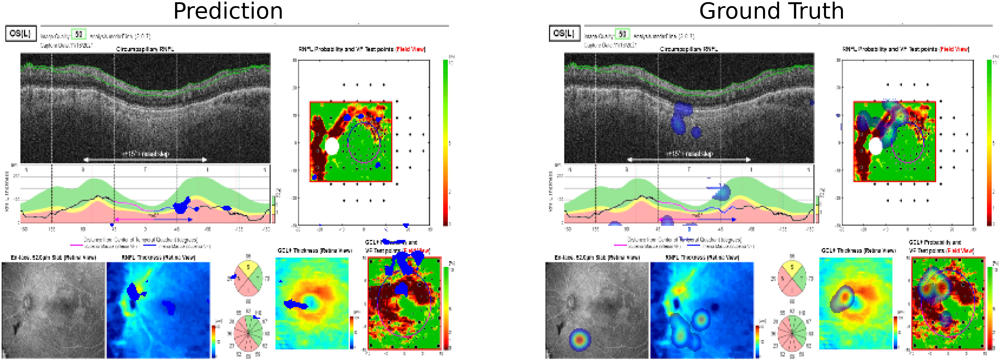

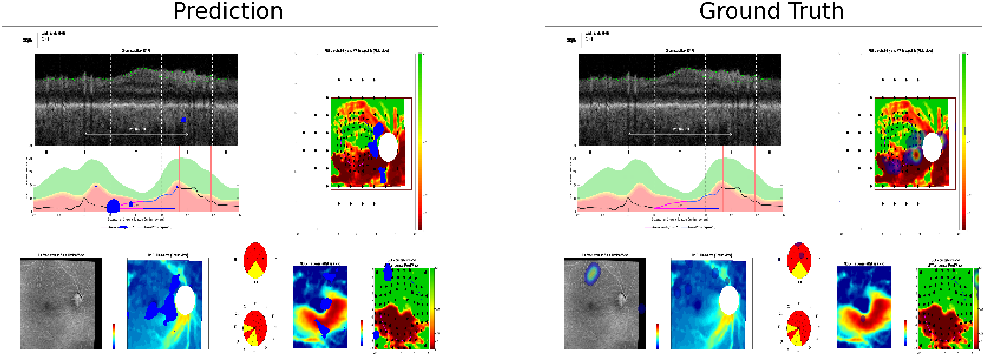

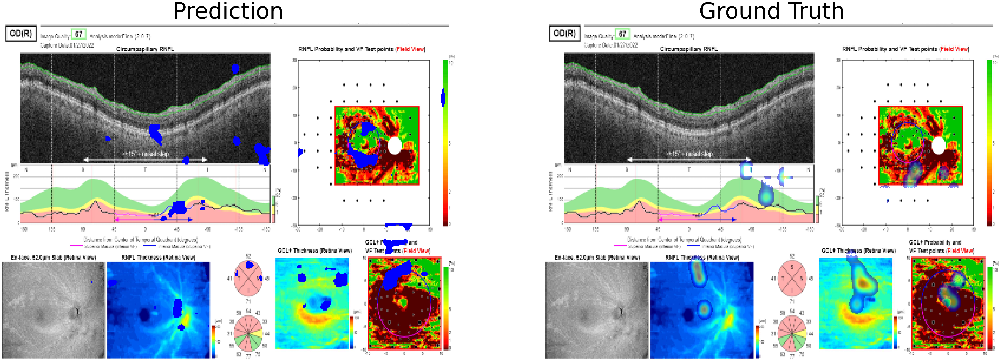

...

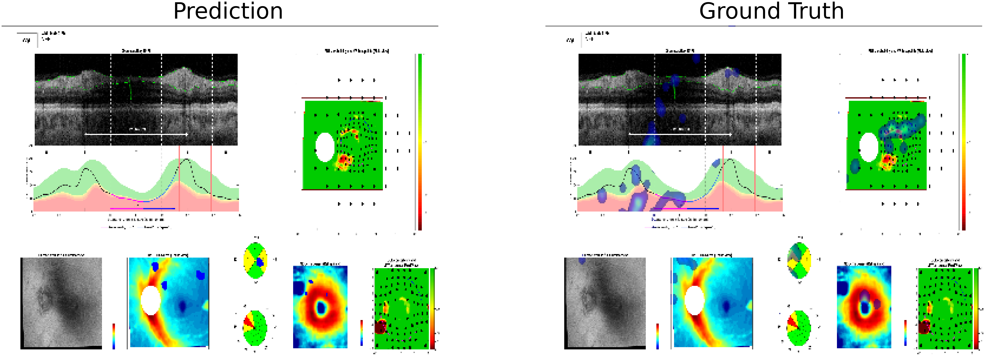

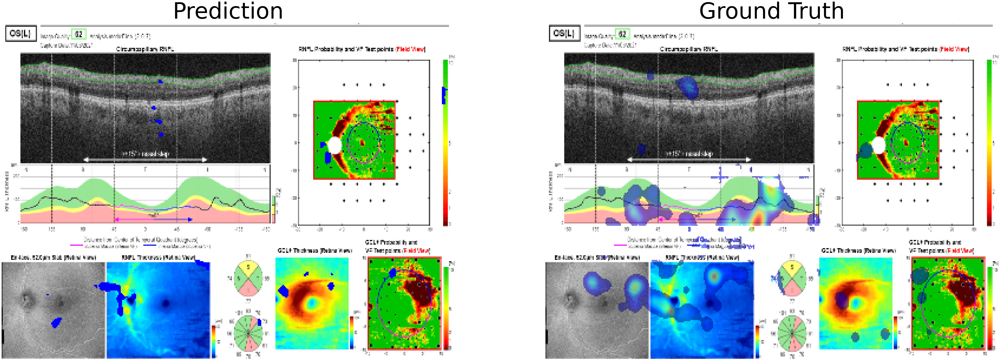

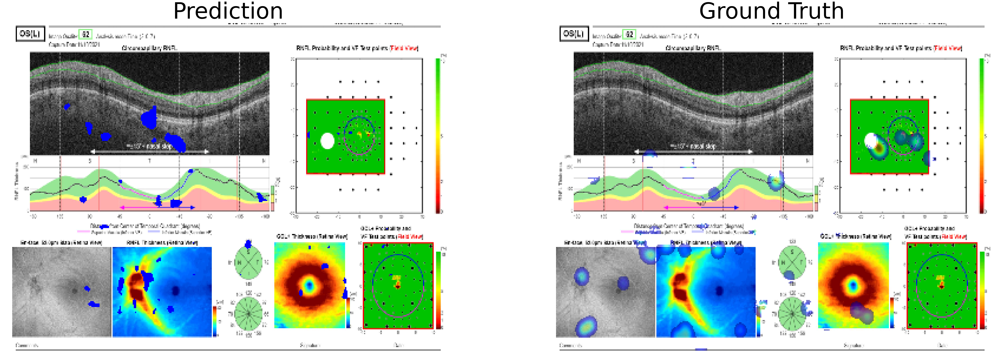

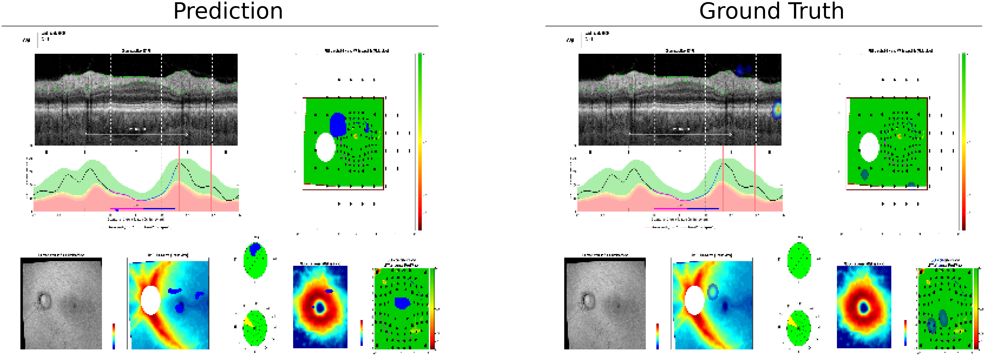

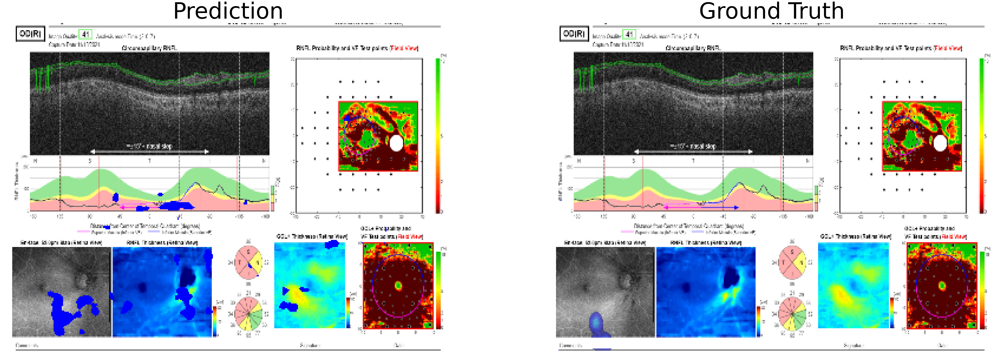

In [39]:
pred_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/3-24-results/predictions"
ground_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/full_data_resized_w_noncontrol_cln/fixation"
orig_folder = "/Users/poojamukund/Documents/Vision Lab/saliency-prediction/full_data_resized_w_noncontrol_cln/stimuli"

get_metrics_and_overlay(pred_folder, ground_folder, orig_folder)

